# Final Project of Deep Learning School (2024 Spring 1 Semester)
## Iakovlev Mikhail (stepik id: 184771749)

## Transfer Style 
### Objective
To train a neural network for style transfer from a style image to a content image. This involves using advanced deep learning techniques to develop a model capable of effectively and accurately applying the stylistic characteristics of one image to another. Additionally, the project aims to develop and deploy an interactive web application using Streamlit, allowing users to upload their images and apply chosen styles to them in real-time.

# Import

In [1]:
import os
import sys
import time
import re
import random
from collections import namedtuple

import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from torch.optim import Adam
from torch.utils.data import DataLoader, random_split
from torchvision import datasets, transforms, models
from tqdm import tqdm

# Transformer architecture

The TransformerNet architecture is a deep neural network designed for the task of style transfer. It consists of several key components:

1. Initial Convolution Layers:

- The network starts with three sequential convolutional layers. Each layer increases the number of channels and reduces the spatial dimensions of the input image.
- Each convolutional layer is followed by instance normalization (InstanceNorm2d) and ReLU activation.

2. Residual Layers:

- The core of the network comprises six residual blocks. These blocks help preserve information passing through the network, leading to more stable training and better generalization.
- Each residual block includes two convolutional layers with instance normalization and ReLU activation. The output of the first convolutional layer is added to the input of the block (residual connection).

3. Upsampling Layers:

- Following the residual layers, there are three upsampling layers that progressively restore the spatial dimensions of the image to its original size.
- Each upsampling layer also includes instance normalization and ReLU activation.

4. Final Convolution Layer:

- The final layer converts the output to an image with three channels (RGB).

5. Non-linearities:

- ReLU activation functions are used throughout the convolutional layers to introduce non-linearity.

In [2]:
class TransformerNet(nn.Module):
    def __init__(self):
        super(TransformerNet, self).__init__()
        # Initial convolution layers
        self.conv1 = ConvLayer(3, 32, kernel_size=9, stride=1)
        self.in1 = nn.InstanceNorm2d(32, affine=True)
        self.conv2 = ConvLayer(32, 64, kernel_size=3, stride=2)
        self.in2 = nn.InstanceNorm2d(64, affine=True)
        self.conv3 = ConvLayer(64, 128, kernel_size=3, stride=2)
        self.in3 = nn.InstanceNorm2d(128, affine=True)
        
        # Residual layers
        self.res_layers = nn.Sequential(
            *[ResidualBlock(128) for _ in range(6)]
        )
        
        # Upsampling Layers
        self.deconv1 = UpsampleConvLayer(128, 64, kernel_size=3, stride=1, upsample=2)
        self.in4 = nn.InstanceNorm2d(64, affine=True)
        self.deconv2 = UpsampleConvLayer(64, 32, kernel_size=3, stride=1, upsample=2)
        self.in5 = nn.InstanceNorm2d(32, affine=True)
        self.deconv3 = ConvLayer(32, 3, kernel_size=9, stride=1)
        
        # Non-linearities
        self.relu = nn.ReLU()

    def forward(self, X):
        y = self.relu(self.in1(self.conv1(X)))
        y = self.relu(self.in2(self.conv2(y)))
        y = self.relu(self.in3(self.conv3(y)))
        y = self.res_layers(y)
        y = self.relu(self.in4(self.deconv1(y)))
        y = self.relu(self.in5(self.deconv2(y)))
        y = self.deconv3(y)
        return y


In [3]:
class ConvLayer(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride):
        super(ConvLayer, self).__init__()
        reflection_padding = kernel_size // 2
        self.reflection_pad = nn.ReflectionPad2d(reflection_padding)
        self.conv2d = nn.Conv2d(in_channels, out_channels, kernel_size, stride)

    def forward(self, x):
        out = self.reflection_pad(x)
        out = self.conv2d(out)
        return out

In [4]:
class ResidualBlock(nn.Module):

    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = ConvLayer(channels, channels, kernel_size=3, stride=1)
        self.in1 = nn.InstanceNorm2d(channels, affine=True)
        self.conv2 = ConvLayer(channels, channels, kernel_size=3, stride=1)
        self.in2 = nn.InstanceNorm2d(channels, affine=True)
        self.relu = nn.ReLU()

    def forward(self, x):
        residual = x
        out = self.relu(self.in1(self.conv1(x)))
        out = self.in2(self.conv2(out))
        out = out + residual
        return out

In [5]:
class UpsampleConvLayer(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size, stride, upsample=None):
        super(UpsampleConvLayer, self).__init__()
        self.upsample = upsample
        reflection_padding = kernel_size // 2
        self.reflection_pad = nn.ReflectionPad2d(reflection_padding)
        self.conv2d = nn.Conv2d(in_channels, out_channels, kernel_size, stride)

    def forward(self, x):
        x_in = x
        if self.upsample:
            x_in = nn.functional.interpolate(x_in, mode='nearest', scale_factor=self.upsample)
        out = self.reflection_pad(x_in)
        out = self.conv2d(out)
        return out

# Utility Functions Block

This block contains essential helper functions required for the project, including:

- Image Loading: Functions to load images from the filesystem.
- Image Preprocessing: Functions to preprocess images for input into the neural network.
- Loss Functions: Definitions of content and style loss functions used during training.
- Other Helpers: Additional utility functions that support various tasks within the project.

In [6]:
def load_image(filename, size=None, scale=None):
    img = Image.open(filename).convert('RGB')
    if size is not None:
        img = img.resize((size, size), Image.ANTIALIAS)
    elif scale is not None:
        new_size = (int(img.size[0] / scale), int(img.size[1] / scale))
        img = img.resize(new_size, Image.ANTIALIAS)
    return img

def save_image(filename, data):
    img = data.clone().clamp(0, 255).numpy()
    img = img.transpose(1, 2, 0).astype("uint8")
    img = Image.fromarray(img)
    img.save(filename)

def normalize_batch(batch):
    mean = torch.tensor([0.485, 0.456, 0.406], device=batch.device).view(1, -1, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225], device=batch.device).view(1, -1, 1, 1)
    batch = batch / 255.0
    return (batch - mean) / std

In [7]:
def get_transform(image_size=256):
    return transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])

def prepare_dataset(image_folder, transform):
    dataset = datasets.ImageFolder(image_folder, transform)
    return dataset

In [8]:
def load_and_transform_style_image(style_image_path, transform, device, batch_size=1):
    style = load_image(style_image_path)
    style = transform(style).unsqueeze(0).to(device)
    style = style.repeat(batch_size, 1, 1, 1)
    return style

In [9]:
def load_and_transform_single_image(image_path, transform, device):
    image = load_image(image_path)
    image = transform(image).unsqueeze(0).to(device)
    return image

In [10]:
def show_style_image(style_image_path, name):
    style_image = Image.open(style_image_path)
    
    plt.figure(figsize=(6, 6))
    plt.title(name)
    plt.imshow(style_image)
    plt.axis('off')
    plt.show()

In [11]:
def show_content_images(image_paths):
    fig, axes = plt.subplots(1, 4, figsize=(20, 5))

    for i, image_path in enumerate(image_paths):
        image = Image.open(image_path)
        axes[i].imshow(image)
        axes[i].axis('off')
        axes[i].set_title(f'Content Image {i+1}')
    
    plt.show()

In [12]:
def display_images(content_image, style_image, transformed_image):
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.title('Original Image')
    original_img = content_image[0].cpu().numpy().transpose(1, 2, 0) / 255.0
    plt.imshow(original_img)
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title('Style Image')
    style_img = style_image.squeeze(0).cpu().numpy().transpose(1, 2, 0) / 255.0
    plt.imshow(style_img)
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title('Transformed Image')
    plt.imshow(transformed_image)
    plt.axis('off')

    plt.show()

In [43]:
def inference_on_cpu(transformer, data_loader, num_images=5):
    transformer.cpu()
    transformer.eval()
    
    fig, axes = plt.subplots(num_images, 2, figsize=(10, num_images * 5))
    axes = axes.flatten()
    
    with torch.no_grad():
        for i, (x, _) in enumerate(data_loader):
            if i >= num_images:
                break
            x = x.cpu()
            transformed_x = transformer(x)

            original_img = x[0].cpu().numpy().transpose(1, 2, 0) / 255.0
            transformed_img = transformed_x[0].cpu().numpy().transpose(1, 2, 0) / 255.0

            axes[i * 2].imshow(original_img.clip(0, 1))
            axes[i * 2].set_title('Original Image')
            axes[i * 2].axis('off')

            axes[i * 2 + 1].imshow(transformed_img.clip(0, 1))
            axes[i * 2 + 1].set_title('Transformed Image')
            axes[i * 2 + 1].axis('off')
    
    plt.tight_layout()
    plt.show()

# Loss Functions in Style Transfer
In this project, we use two primary loss functions to achieve style transfer: the Style Loss and the Content Loss.

**1. Content Loss**
- Purpose: The content loss ensures that the generated image retains the structure and details of the content image.
- Implementation: This loss is calculated using the feature representations from a specific layer (e.g., relu2_2) of the pretrained VGG16 network. By comparing the features of the content image and the generated image, the content loss penalizes differences, thereby encouraging the generated image to preserve the content of the original.

In [13]:
class Vgg16(nn.Module):
    def __init__(self, requires_grad=False):
        super(Vgg16, self).__init__()
        vgg_pretrained_features = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1).features
        self.slice1 = nn.Sequential()
        self.slice2 = nn.Sequential()
        self.slice3 = nn.Sequential()
        self.slice4 = nn.Sequential()
        for x in range(4):
            self.slice1.add_module(str(x), vgg_pretrained_features[x])
        for x in range(4, 9):
            self.slice2.add_module(str(x), vgg_pretrained_features[x])
        for x in range(9, 16):
            self.slice3.add_module(str(x), vgg_pretrained_features[x])
        for x in range(16, 23):
            self.slice4.add_module(str(x), vgg_pretrained_features[x])
        if not requires_grad:
            for param in self.parameters():
                param.requires_grad = False

    def forward(self, X):
        h = self.slice1(X)
        h_relu1_2 = h
        h = self.slice2(h)
        h_relu2_2 = h
        h = self.slice3(h)
        h_relu3_3 = h
        h = self.slice4(h)
        h_relu4_3 = h
        vgg_outputs = namedtuple("VggOutputs", ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3'])
        out = vgg_outputs(h_relu1_2, h_relu2_2, h_relu3_3, h_relu4_3)
        return out


**2. Style Loss**
- Purpose: The style loss ensures that the generated image mimics the texture and patterns of the style image.
- Implementation: This loss is calculated using the Gram Matrix, which captures the spatial correlations between different feature channels. By comparing the Gram Matrices of the style image and the generated image, the style loss penalizes differences in style.

In [14]:
def gram_matrix(y):
    (b, ch, h, w) = y.size()
    features = y.view(b, ch, w * h)
    features_t = features.transpose(1, 2)
    gram = features.bmm(features_t) / (ch * h * w)
    return gram

# Model and Training Setup

In [15]:
# Ensures consistent random number generation across runs.
np.random.seed(42)
torch.manual_seed(42)

In [16]:
# Checks if a GPU is available and sets the computation device accordingly.
device = "cuda" if torch.cuda.is_available() else "cpu"

For the training process, I utilized a comprehensive dataset consisting of 400 images depicting various landscapes.

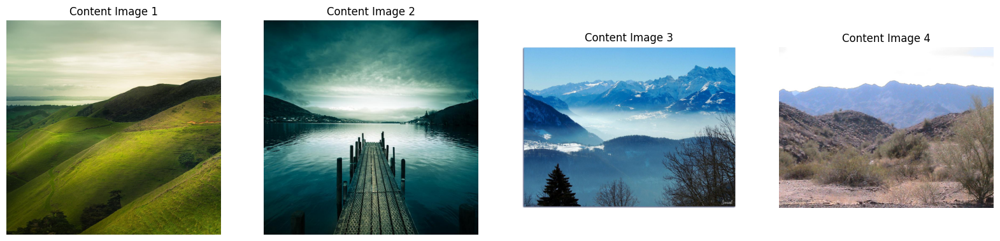

In [17]:
content_image_paths = [
    'images/content/class1/content_1.jpg',
    'images/content/class1/content_2.jpg',
    'images/content/class1/content_3.jpg',
    'images/content/class1/content_4.jpg'
]

# Display the content images
show_content_images(content_image_paths)

In [19]:
# Defines and applies transformations to the content images, then loads them for training.
transform = get_transform()
dataset = prepare_dataset('images/content', transform)

train_size = int(0.9 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=1)

# Initializes the style transfer model and optimizer.
transformer = TransformerNet().to(device)
optimizer = Adam(transformer.parameters(), lr=1e-3)

# Initializes the pretrained VGG16 model for feature extraction, without updating its weights during training.
vgg = Vgg16(requires_grad=False).to(device)

In [20]:
# Defines transformations for the style image.
style_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Lambda(lambda x: x.mul(255))
])

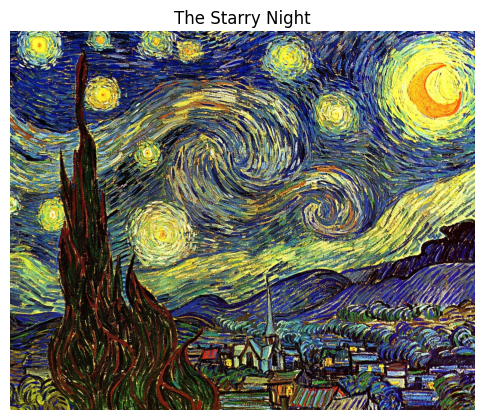

In [21]:
# Display the style image
style_image_path = 'images/style_images/style2.jpg'
show_style_image(style_image_path, 'The Starry Night')

In [22]:
# Loads and transforms the style image.
style = load_and_transform_style_image(style_image_path, style_transform, device)
features_style = vgg(normalize_batch(style))
gram_style = [gram_matrix(y) for y in features_style]

# Training the Model

The training block is a critical section where the neural network is trained to perform style transfer. This process involves several key steps:

1. Training Loop:

- Epoch Loop: The training process iterates over a specified number of epochs. Each epoch represents one complete pass through the training dataset.
- Batch Processing: For each batch of content images:
- a) *Forward Pass: The content images are passed through the transformer network to generate styled images.*
- b) *Loss Calculation: The content loss and style loss are calculated using the VGG network's feature maps and Gram matrices.*
- c) *Backward Pass and Optimization: The total loss (sum of content and style losses) is backpropagated, and the optimizer updates the transformer network's parameters to minimize the loss.*
- d) *Loss Tracking: The content, style, and total losses for the training data are recorded and averaged for each epoch.*

2. Validation:

- Epoch End Validation: After each epoch, the model is evaluated on the validation dataset to monitor its performance.
- a) *Forward Pass: The validation images are passed through the transformer network.*
- b) *Loss Calculation: The content and style losses are computed similarly to the training phase.*
- c) *Loss Tracking: The content, style, and total losses for the validation data are recorded and averaged for each epoch.*

3. Visualization:

- Periodic Visualization: At regular intervals (every 20 epochs), the style transfer results are visualized by applying the transformer network to the main content image and displaying the transformed image alongside the original and style images.

4. Results:

- Loss Plotting: After training, the content, style, and total losses for both training and validation data are plotted to visualize the model's learning progress.

In [26]:
def train(transformer, 
          vgg, 
          train_loader, 
          val_loader,
          optimizer, 
          device, 
          gram_style, 
          style_image,
          inference_image_path='images/inference/main-zurich.jpg',
          epochs=10, 
          content_weight=1, 
          style_weight=1e5):
    
    mse_loss = nn.MSELoss().to(device)

    train_content_losses = []
    train_style_losses = []
    train_total_losses = []
    
    val_content_losses = []
    val_style_losses = []
    val_total_losses = []

    main_image = load_and_transform_single_image(inference_image_path, transform, device)

    for epoch in tqdm(range(epochs)):
        transformer.train()
        train_agg_content_loss = 0.0
        train_agg_style_loss = 0.0

        for batch_id, (x, _) in enumerate(train_loader):
            optimizer.zero_grad()

            x = x.to(device)
            y = transformer(x)

            y = normalize_batch(y)
            x = normalize_batch(x)

            features_y = vgg(y)
            features_x = vgg(x)

            content_loss = content_weight * mse_loss(features_y.relu2_2, features_x.relu2_2)

            style_loss = 0.0
            for ft_y, gm_s in zip(features_y, gram_style):
                gm_y = gram_matrix(ft_y)
                style_loss += mse_loss(gm_y, gm_s[:x.size(0), :, :])
            style_loss *= style_weight

            total_loss = content_loss + style_loss
            total_loss.backward()
            optimizer.step()

            train_agg_content_loss += content_loss.item()
            train_agg_style_loss += style_loss.item()

        # Average training losses for the epoch
        train_content_losses.append(train_agg_content_loss / len(train_loader))
        train_style_losses.append(train_agg_style_loss / len(train_loader))
        train_total_losses.append((train_agg_content_loss + train_agg_style_loss) / len(train_loader))      

        # Validation loop
        transformer.eval()
        val_agg_content_loss = 0.0
        val_agg_style_loss = 0.0
        with torch.no_grad():
            for val_batch_id, (x, _) in enumerate(val_loader):
                x = x.to(device)
                y = transformer(x)

                y = normalize_batch(y)
                x = normalize_batch(x)

                features_y = vgg(y)
                features_x = vgg(x)

                content_loss = content_weight * mse_loss(features_y.relu2_2, features_x.relu2_2)

                style_loss = 0.0
                for ft_y, gm_s in zip(features_y, gram_style):
                    gm_y = gram_matrix(ft_y)
                    style_loss += mse_loss(gm_y, gm_s[:x.size(0), :, :])
                style_loss *= style_weight

                val_agg_content_loss += content_loss.item()
                val_agg_style_loss += style_loss.item()

        # Average validation losses for the epoch
        val_content_losses.append(val_agg_content_loss / len(val_loader))
        val_style_losses.append(val_agg_style_loss / len(val_loader))
        val_total_losses.append((val_agg_content_loss + val_agg_style_loss) / len(val_loader))
        if (epoch + 1) % 5 == 0:
            # Print losses every 5 epochs
            print(f"Epoch {epoch+1}/{epochs}, Training - Content Loss: {train_content_losses[-1]:.6f}, Style Loss: {train_style_losses[-1]:.6f}, Total Loss: {train_total_losses[-1]:.6f}")
            print(f"Epoch {epoch+1}/{epochs}, Validation - Content Loss: {val_content_losses[-1]:.6f}, Style Loss: {val_style_losses[-1]:.6f}, Total Loss: {val_total_losses[-1]:.6f}")

        # Style transfer visualization on main image every 20 epochs
        if (epoch + 1) % 20 == 0:
            with torch.no_grad():
                transformer.eval()
                transformed_main_image = transformer(main_image)
                transformed_main_image = transformed_main_image[0].cpu().numpy().transpose(1, 2, 0) / 255.0
                display_images(main_image, style_image, transformed_main_image)

        transformer.to(device).train()

    return train_content_losses, train_style_losses, train_total_losses, val_content_losses, val_style_losses, val_total_losses

  5%|▌         | 5/100 [01:01<19:18, 12.19s/it]

Epoch 5/100, Training - Content Loss: 7.122289, Style Loss: 1.982930, Total Loss: 9.105218
Epoch 5/100, Validation - Content Loss: 6.535618, Style Loss: 2.121131, Total Loss: 8.656749


 10%|█         | 10/100 [02:01<18:14, 12.17s/it]

Epoch 10/100, Training - Content Loss: 6.221943, Style Loss: 1.624978, Total Loss: 7.846921
Epoch 10/100, Validation - Content Loss: 6.124660, Style Loss: 1.617786, Total Loss: 7.742446


 15%|█▌        | 15/100 [03:02<17:12, 12.15s/it]

Epoch 15/100, Training - Content Loss: 5.754891, Style Loss: 1.421980, Total Loss: 7.176871
Epoch 15/100, Validation - Content Loss: 5.724561, Style Loss: 1.535548, Total Loss: 7.260108


 19%|█▉        | 19/100 [03:51<16:24, 12.15s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20/100, Training - Content Loss: 5.472171, Style Loss: 1.315444, Total Loss: 6.787614
Epoch 20/100, Validation - Content Loss: 5.465821, Style Loss: 1.475195, Total Loss: 6.941016


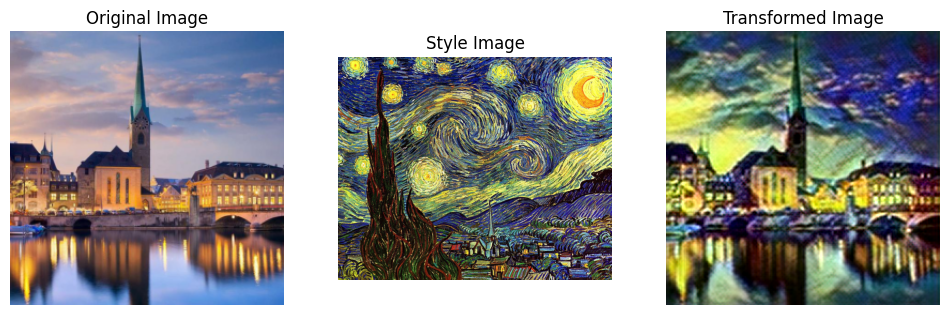

 25%|██▌       | 25/100 [05:04<15:14, 12.19s/it]

Epoch 25/100, Training - Content Loss: 5.261869, Style Loss: 1.225603, Total Loss: 6.487471
Epoch 25/100, Validation - Content Loss: 5.308393, Style Loss: 1.448035, Total Loss: 6.756429


 30%|███       | 30/100 [06:05<14:11, 12.16s/it]

Epoch 30/100, Training - Content Loss: 5.118111, Style Loss: 1.152342, Total Loss: 6.270453
Epoch 30/100, Validation - Content Loss: 5.311445, Style Loss: 1.327978, Total Loss: 6.639423


 35%|███▌      | 35/100 [07:06<13:08, 12.13s/it]

Epoch 35/100, Training - Content Loss: 5.002879, Style Loss: 1.103306, Total Loss: 6.106185
Epoch 35/100, Validation - Content Loss: 5.207659, Style Loss: 1.313745, Total Loss: 6.521405


 39%|███▉      | 39/100 [07:55<12:22, 12.18s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40/100, Training - Content Loss: 4.914642, Style Loss: 1.067900, Total Loss: 5.982542
Epoch 40/100, Validation - Content Loss: 5.054621, Style Loss: 1.394504, Total Loss: 6.449125


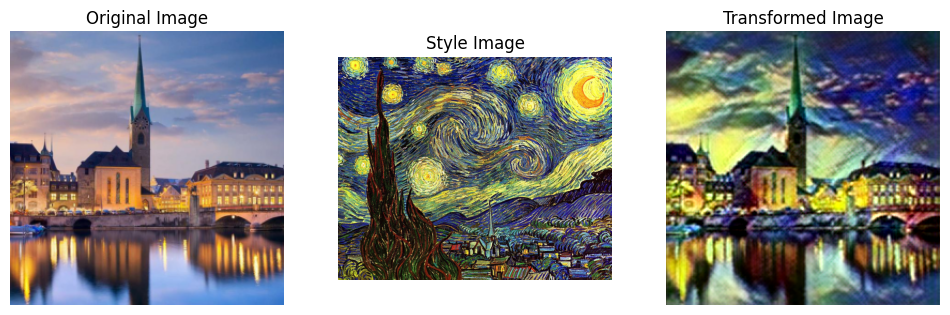

 45%|████▌     | 45/100 [09:08<11:09, 12.16s/it]

Epoch 45/100, Training - Content Loss: 4.826930, Style Loss: 1.036226, Total Loss: 5.863156
Epoch 45/100, Validation - Content Loss: 5.025108, Style Loss: 1.374080, Total Loss: 6.399188


 50%|█████     | 50/100 [10:09<10:07, 12.16s/it]

Epoch 50/100, Training - Content Loss: 4.761819, Style Loss: 1.020298, Total Loss: 5.782117
Epoch 50/100, Validation - Content Loss: 5.001862, Style Loss: 1.356639, Total Loss: 6.358500


 55%|█████▌    | 55/100 [11:09<09:06, 12.15s/it]

Epoch 55/100, Training - Content Loss: 4.704429, Style Loss: 0.986088, Total Loss: 5.690518
Epoch 55/100, Validation - Content Loss: 4.937762, Style Loss: 1.386402, Total Loss: 6.324164


 59%|█████▉    | 59/100 [11:58<08:20, 12.20s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60/100, Training - Content Loss: 4.655467, Style Loss: 0.957984, Total Loss: 5.613451
Epoch 60/100, Validation - Content Loss: 4.917949, Style Loss: 1.364379, Total Loss: 6.282328


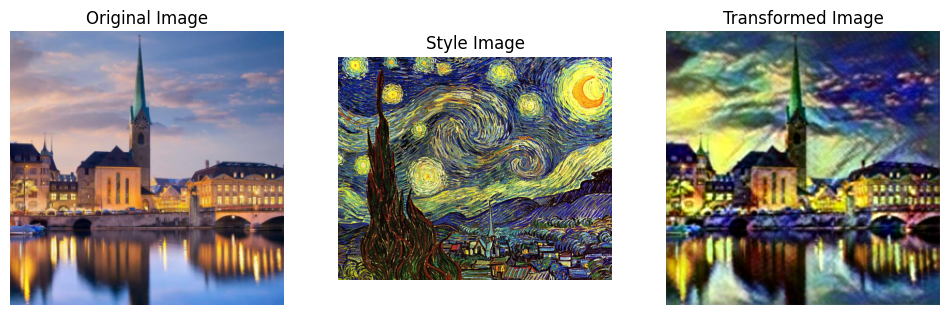

 65%|██████▌   | 65/100 [13:12<07:07, 12.21s/it]

Epoch 65/100, Training - Content Loss: 4.621079, Style Loss: 0.948741, Total Loss: 5.569820
Epoch 65/100, Validation - Content Loss: 4.865651, Style Loss: 1.399370, Total Loss: 6.265021


 70%|███████   | 70/100 [14:13<06:04, 12.15s/it]

Epoch 70/100, Training - Content Loss: 4.584822, Style Loss: 0.937251, Total Loss: 5.522073
Epoch 70/100, Validation - Content Loss: 4.883405, Style Loss: 1.359981, Total Loss: 6.243386


 75%|███████▌  | 75/100 [15:14<05:04, 12.17s/it]

Epoch 75/100, Training - Content Loss: 4.556860, Style Loss: 0.930408, Total Loss: 5.487269
Epoch 75/100, Validation - Content Loss: 4.846156, Style Loss: 1.411052, Total Loss: 6.257208


 79%|███████▉  | 79/100 [16:03<04:18, 12.30s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 80/100, Training - Content Loss: 4.526746, Style Loss: 0.912574, Total Loss: 5.439320
Epoch 80/100, Validation - Content Loss: 4.768158, Style Loss: 1.487578, Total Loss: 6.255737


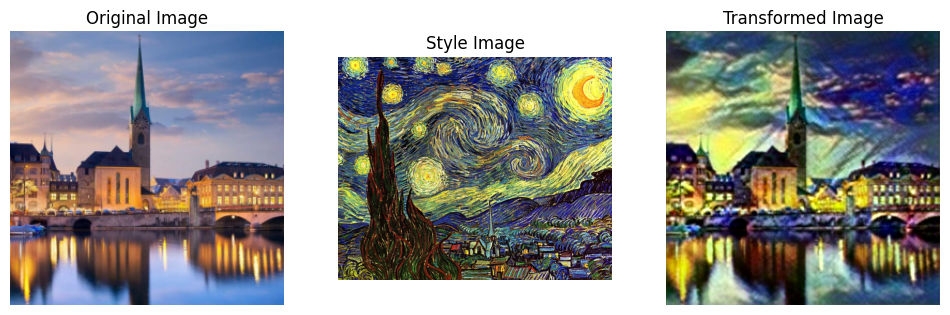

 85%|████████▌ | 85/100 [17:14<02:56, 11.75s/it]

Epoch 85/100, Training - Content Loss: 4.503411, Style Loss: 0.895337, Total Loss: 5.398749
Epoch 85/100, Validation - Content Loss: 4.773682, Style Loss: 1.429195, Total Loss: 6.202878


 90%|█████████ | 90/100 [18:13<01:57, 11.78s/it]

Epoch 90/100, Training - Content Loss: 4.485958, Style Loss: 0.896794, Total Loss: 5.382753
Epoch 90/100, Validation - Content Loss: 4.792622, Style Loss: 1.419793, Total Loss: 6.212414


 95%|█████████▌| 95/100 [19:13<00:59, 11.93s/it]

Epoch 95/100, Training - Content Loss: 4.469999, Style Loss: 0.890351, Total Loss: 5.360350
Epoch 95/100, Validation - Content Loss: 4.814229, Style Loss: 1.399087, Total Loss: 6.213316


 99%|█████████▉| 99/100 [20:01<00:11, 11.96s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 100/100, Training - Content Loss: 4.453434, Style Loss: 0.884365, Total Loss: 5.337800
Epoch 100/100, Validation - Content Loss: 4.784100, Style Loss: 1.429256, Total Loss: 6.213356


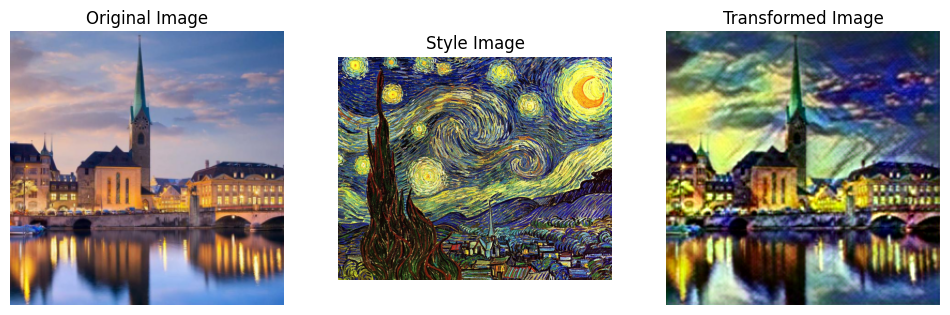

100%|██████████| 100/100 [20:13<00:00, 12.14s/it]


In [27]:
train_content_losses, train_style_losses, train_total_losses, val_content_losses, val_style_losses, val_total_losses = train(transformer, vgg, train_loader, val_loader, optimizer, device, gram_style, style, epochs=100)

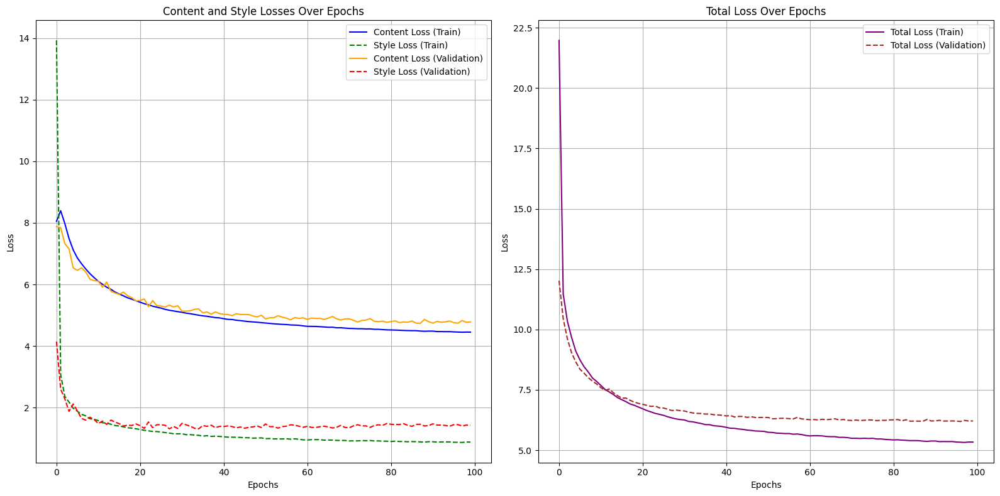

In [30]:
# Plotting content and style losses
plt.figure(figsize=(16, 8))

# Plot for content and style losses
plt.subplot(1, 2, 1)
plt.plot(train_content_losses, label='Content Loss (Train)', linestyle='-', color='blue')
plt.plot(train_style_losses, label='Style Loss (Train)', linestyle='--', color='green')
plt.plot(val_content_losses, label='Content Loss (Validation)', linestyle='-', color='orange')
plt.plot(val_style_losses, label='Style Loss (Validation)', linestyle='--', color='red')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Content and Style Losses Over Epochs')
plt.legend()
plt.grid(True)

# Plot for total losses
plt.subplot(1, 2, 2)
plt.plot(train_total_losses, label='Total Loss (Train)', linestyle='-', color='purple')
plt.plot(val_total_losses, label='Total Loss (Validation)', linestyle='--', color='brown')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Total Loss Over Epochs')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


In the graphs, we can observe the loss functions for both the training and validation datasets. We see that around the 20th epoch, the style loss stabilizes and does not change significantly. In contrast, the content loss gradually decreases up to the 100th epoch. The overall loss shows that after the 50th epoch, the loss changes only slightly.

When looking at the inference results after every 20 epochs, it is evident that the image becomes sharper and less blurry over time.

# Inference

In [44]:
device = "cpu"

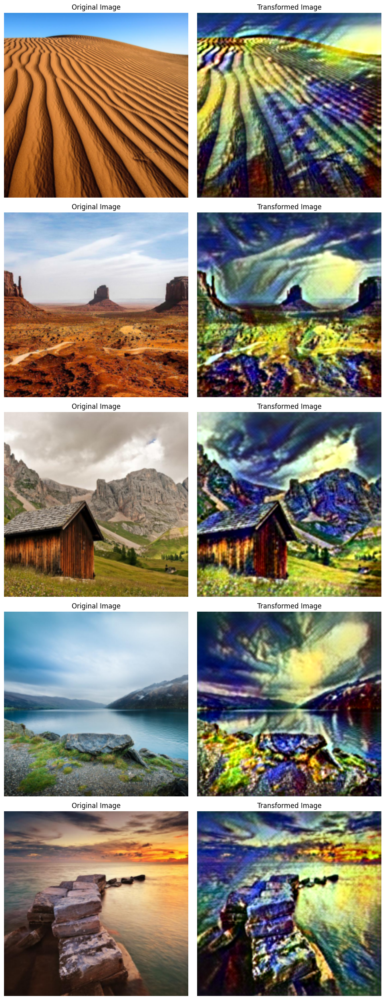

In [55]:
inference_on_cpu(transformer, train_loader)

# Conclusion
In this project, we successfully implemented and trained a neural network for artistic style transfer, allowing us to apply the artistic style of one image onto the content of another. Here are the key accomplishments and observations from the project:

1. Model Architecture:

- We designed and implemented a Transformer network that effectively combines the features of the VGG16 network to perform style transfer. - The architecture includes initial convolution layers, residual blocks, and upsampling layers to reconstruct the styled image.

2. Training Process:

- The training process involved minimizing both content and style losses. The content loss ensured that the output image retained the structure of the content image, while the style loss ensured that the style of the style image was applied to the output.
- We used a dataset of 400 landscape images, with 90% for training and 10% for validation. The training was monitored through both training and validation losses to ensure the model's effectiveness and generalization.

3. Observations from Loss Plots:

- The loss plots revealed that the style loss stabilized around the 20th epoch, indicating that the model quickly learned to capture the style features. In contrast, the content loss continued to decrease gradually, suggesting continuous improvement in retaining content details.
- The total loss showed minimal changes after the 50th epoch, suggesting that further training had diminishing returns on the model's performance.
- Inference results demonstrated a noticeable improvement in image clarity and reduction in blurriness after every 20 epochs, confirming the model's progressive enhancement in applying the style effectively.

4. Inference and Visualization:

- The inference process allowed us to visualize the results of style transfer on various content images, showcasing the model's ability to produce visually appealing styled images.
- Regular visualization during training helped in assessing the qualitative progress of the model, ensuring that the output images met the desired artistic effect.

# Future Application
Following the initial experiments, the model was further trained for 200 and 500 epochs on seven different styles. These models were converted to the ONNX format, and an application was developed using Streamlit, packaged in a Docker container, and deployed on Digital Ocean.



In [59]:
def show_styles_images(style_photo_paths):
    num_styles = len(style_photo_paths)
    plt.figure(figsize=(15, num_styles * 2))

    for i, (name, path) in enumerate(style_photo_paths.items()):
        style_image = Image.open(path)
        plt.subplot(num_styles // 2 + 1, 2, i + 1)
        plt.title(name)
        plt.imshow(style_image)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

In [60]:
style_photo_paths = {
    "The Scream": "images/style_images/style1.jpg",
    "The Starry Night": "images/style_images/style2.jpg",
    "The Dance": "images/style_images/style3.jpg",
    "The Papal Palace": "images/style_images/style4.jpg",
    "Louis Valtat": "images/style_images/style5.jpg",
    "Diana Malivani": "images/style_images/style6.jpg",
    "Kangchenjunga": "images/style_images/style7.jpg"
}

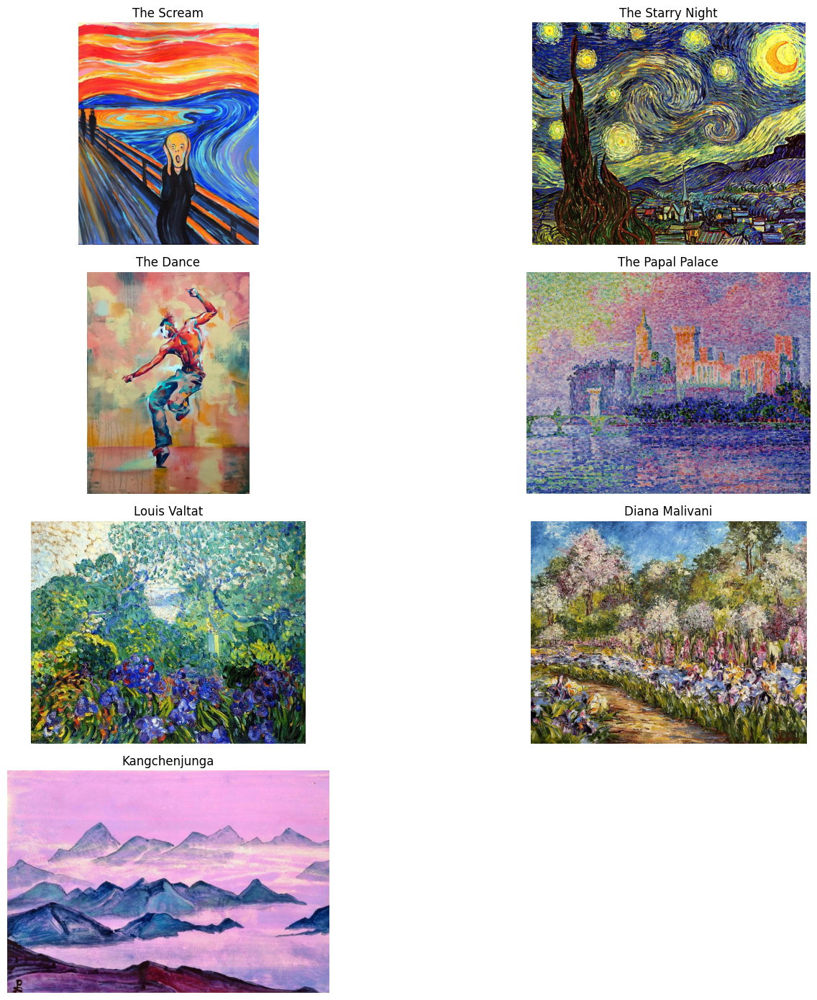

In [61]:
# Display all style images
show_styles_images(style_photo_paths)

In [84]:
def display_style_transfer_results(original_image_path):
    original_image = Image.open(original_image_path)
    original_image = resize_image_proportionally(original_image, 512)

    fig, axes = plt.subplots(7, 3, figsize=(15, 35))

    for i, (style_name, model_path) in enumerate(model_paths.items()):
        style_image_path = style_photo_paths[style_name]

        style_image = Image.open(style_image_path)
        style_image = resize_image_proportionally(style_image, 512)

        # Apply style transfer
        styled_image = stylize(original_image, model_path)
        styled_image = image_preprocess(styled_image)

        # Display original image
        axes[i, 0].imshow(original_image)
        axes[i, 0].set_title("Original Image")
        axes[i, 0].axis('off')

        # Display style image
        axes[i, 1].imshow(style_image)
        axes[i, 1].set_title(f"Style: {style_name}")
        axes[i, 1].axis('off')

        # Display styled image
        axes[i, 2].imshow(styled_image)
        axes[i, 2].set_title("Styled Image")
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()

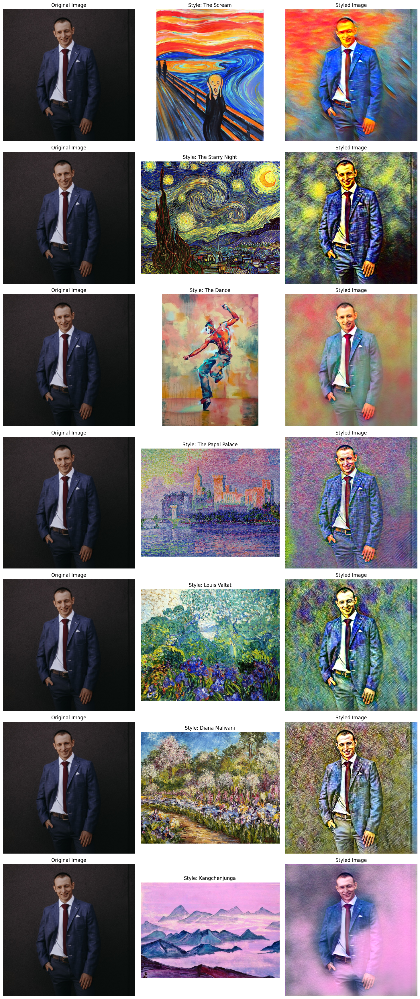

In [85]:
display_style_transfer_results("./images/inference/inference1.jpg")

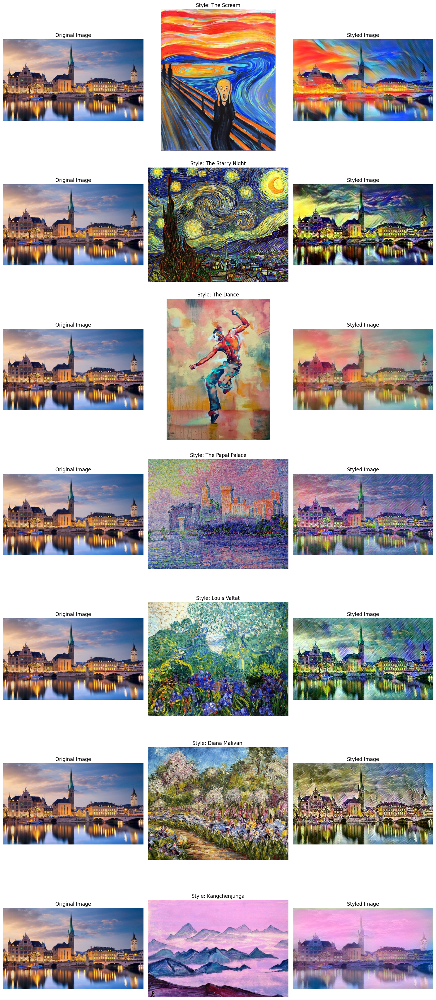

In [86]:
display_style_transfer_results("./images/inference/inference2.jpg")